# Scraping Webtoons Illustrations From Original Comic Episodes

In [1]:
import asyncio
import aiohttp
import time
import requests
from bs4 import BeautifulSoup
import regex as re
import math
import os
import aiofiles
from PIL import Image, ImageDraw, UnidentifiedImageError
import io

## Scraping Example

In [19]:
# Example Functions
def create_episode_img(episode_url, k_pages=1000, display_pages=False):
    r = requests.get(episode_url)
    soup = BeautifulSoup(r.content, 'html.parser')
    imgs = []
    total_height = 0
    for img in list(soup.find_all('img', class_='_images'))[:k_pages]:
        img_url = re.sub("\?type=\w*", "", img['data-url'])
        response = requests.get(img_url, headers={"referer": "https://www.webtoons.com/"}, timeout=None)
        img = Image.open(io.BytesIO(response.content))
        if display_pages:
            display(img)
        total_height += img.size[1]
        if total_height > 65500: # 65500 is the max image dimension for Pillow
            total_height -= img.size[1]
            break
        imgs.append(img)

    max_width = max([img.size[0] for img in imgs])

    episode_img = Image.new('RGB', (max_width, total_height))
    
    y_offset = 0
    for img in imgs:
        if img.size[0] != max_width:
            img = img.resize((max_width, int(img.size[1] * max_width / img.size[0])), Image.Resampling.LANCZOS)
        episode_img.paste(img, (0,y_offset))
        y_offset += img.size[1]

    return episode_img

def segment_lines_episode(episode_img, k_pages=3):
    width, height = episode_img.size
    prev_row = False
    draw = ImageDraw.Draw(episode_img)
    top = 0
    bottom = 0
    cropped_imgs = []
    
    for y in range(height): # Iterate over rows
        color = episode_img.getpixel((0,y))
        full_row = True
        for x in range(width):
            if episode_img.getpixel((x,y)) != color:
                full_row = False
                break
        if full_row:
            if not prev_row:
                draw.line((0,y, width,y), fill=(255,0,0), width=1)
                bottom = y
                if bottom-top > 200:
                    cropped_imgs.append(episode_img.crop((0, top, width, bottom)))
            prev_row = True
        else:
            if prev_row:
                draw.line((0,y, width,y), fill=(0,255,0), width=1)
                top = y
            prev_row = False
    
    cropped_imgs.sort(key=lambda img: abs(math.log(img.size[1]/img.size[0]))) # sort by squareness

    
    return cropped_imgs[:k_pages] # top k squarest images

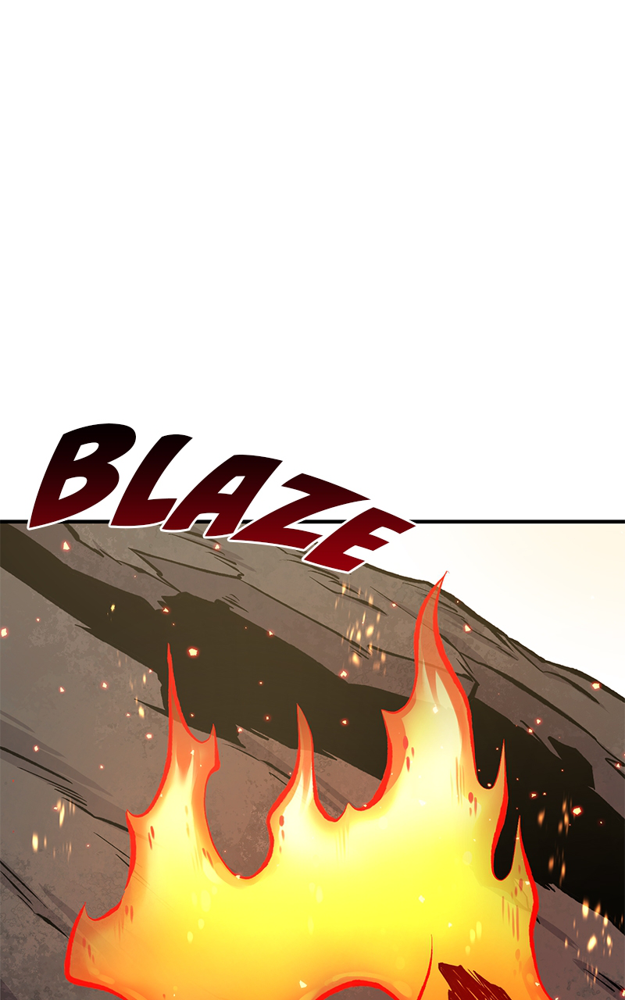

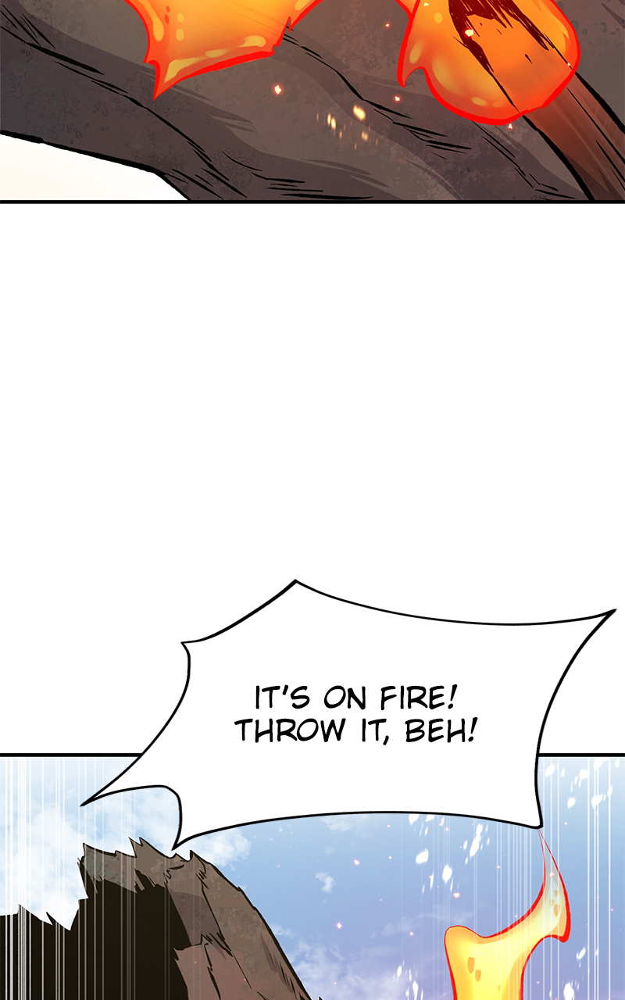

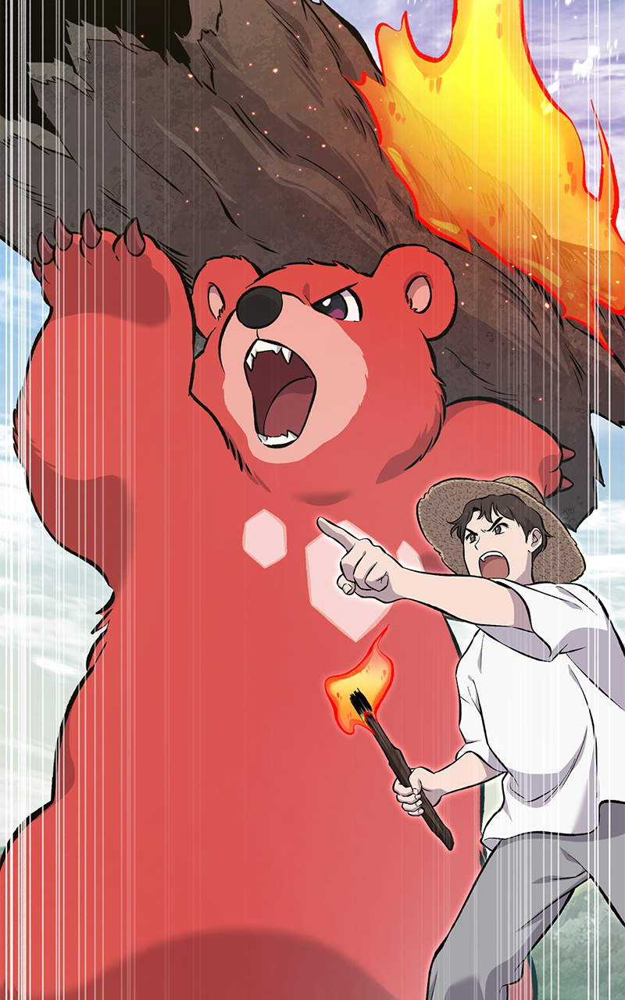

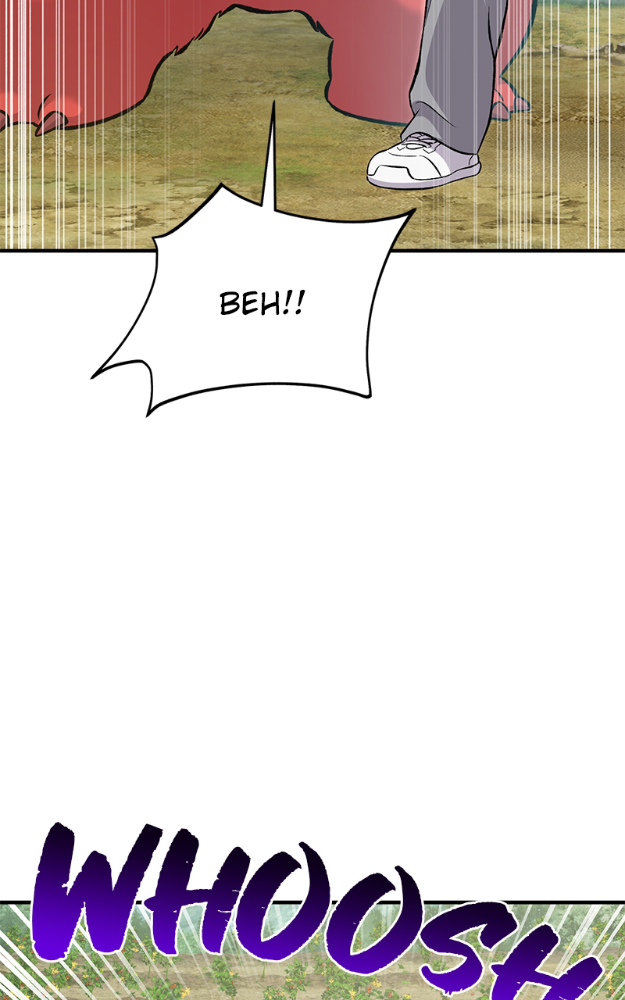

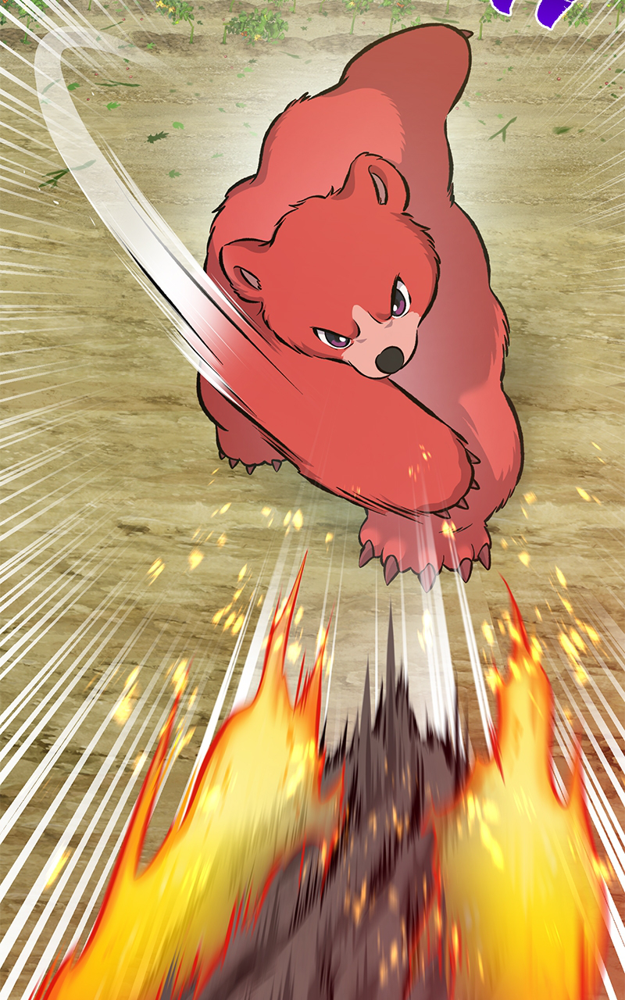

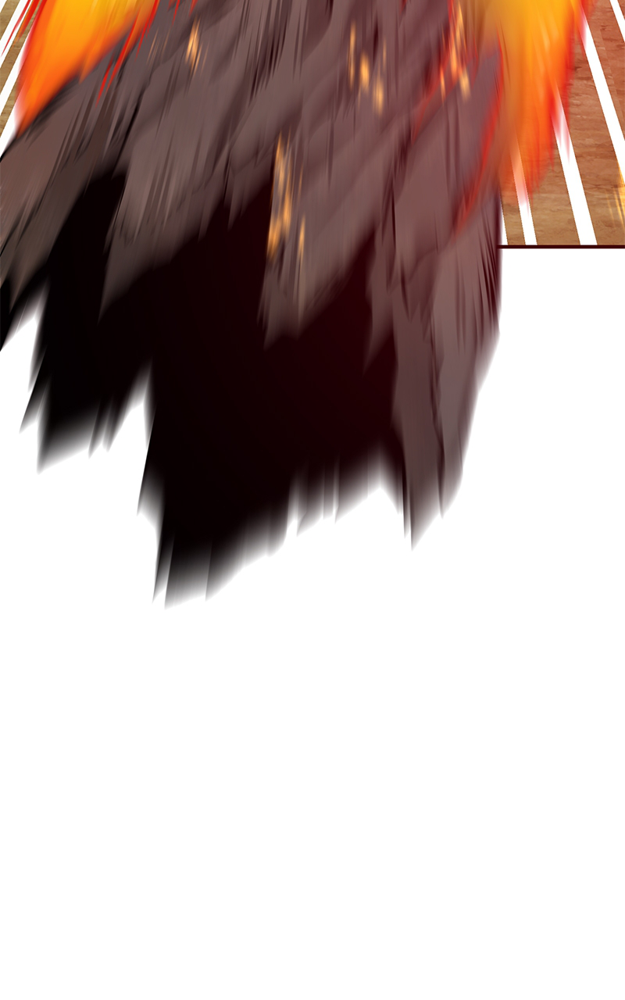

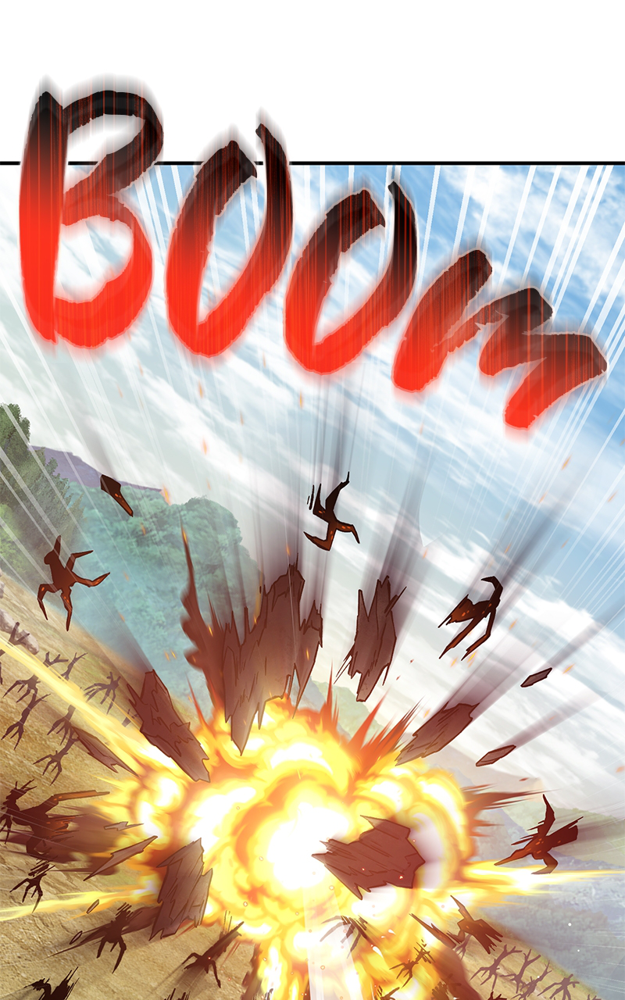

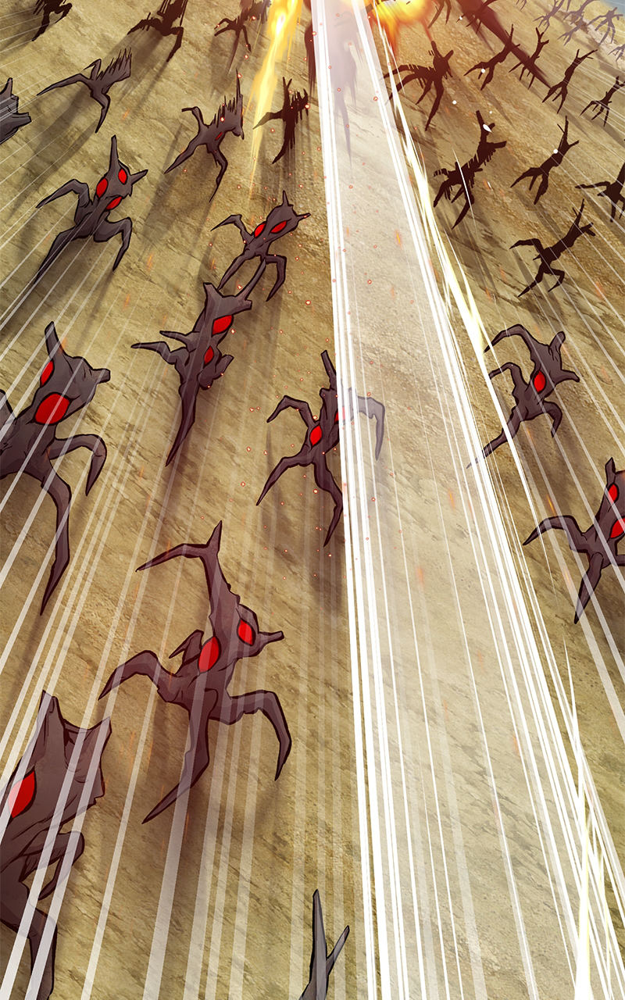

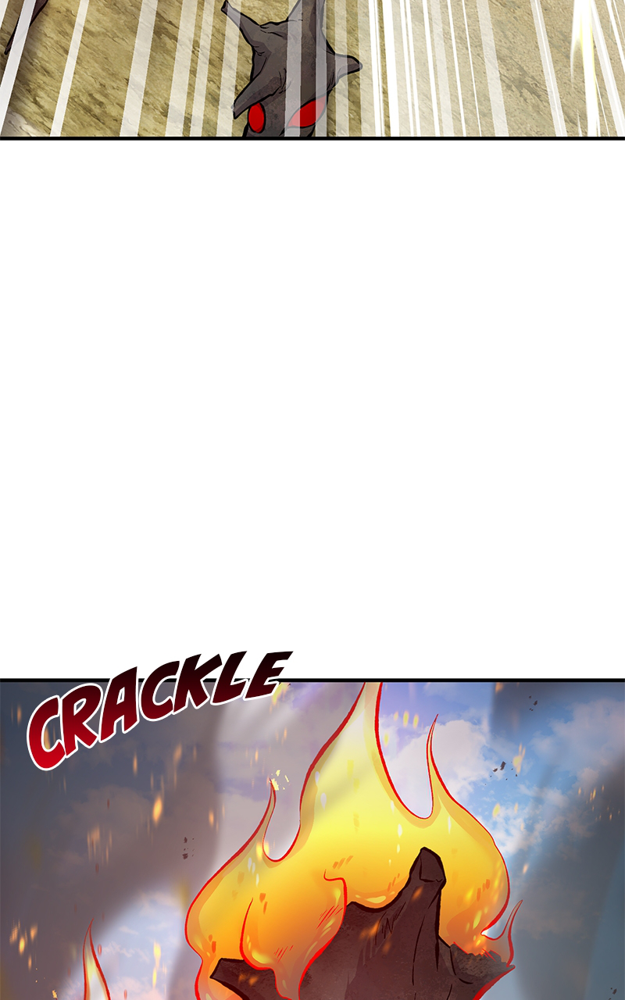

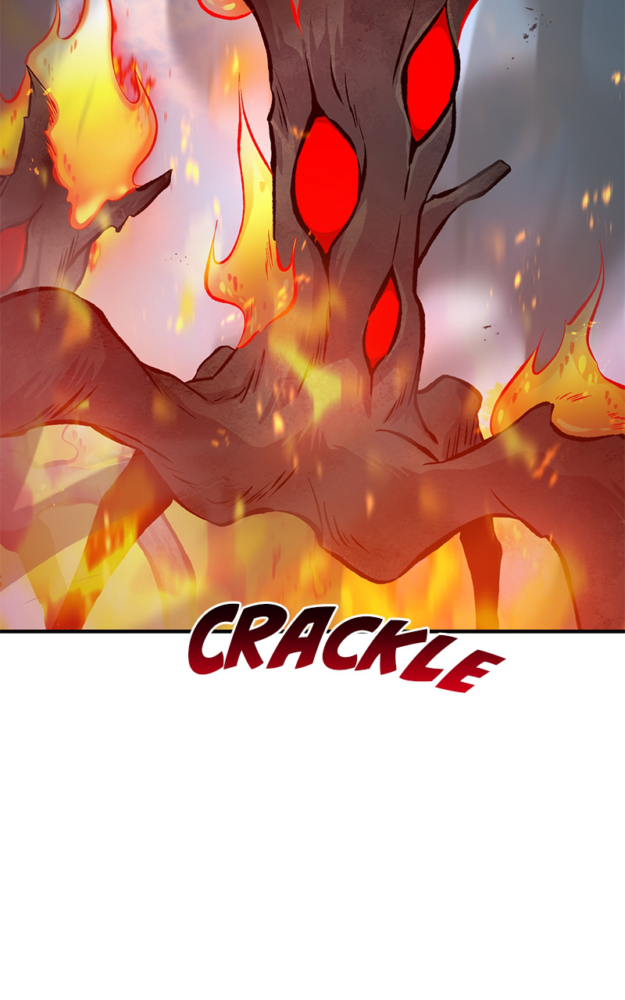

In [14]:
# Demonstrates how WebToons segments episodes into pages/images
# White lines indicate separation between images.
sample_episode_url = "https://www.webtoons.com/en/fantasy/the-top-dungeon-farmer/ep-72-truth-revealed/viewer?title_no=5656&episode_no=72"
sample_episode_img = create_episode_img(sample_episode_url, k_pages=10, display_pages=True)

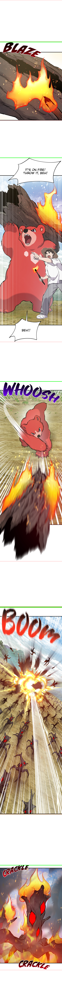

In [22]:
# Demonstrates how WebToons segments episodes into pages/images 
# Green is the top of a page and red is the bottom of a page
# Note: Green and red lines are purely for example purposes only and are removed for the real scraping process
sample_segmented_imgs = segment_lines_episode(sample_episode_img, k_pages=3)
display(sample_episode_img)

img1


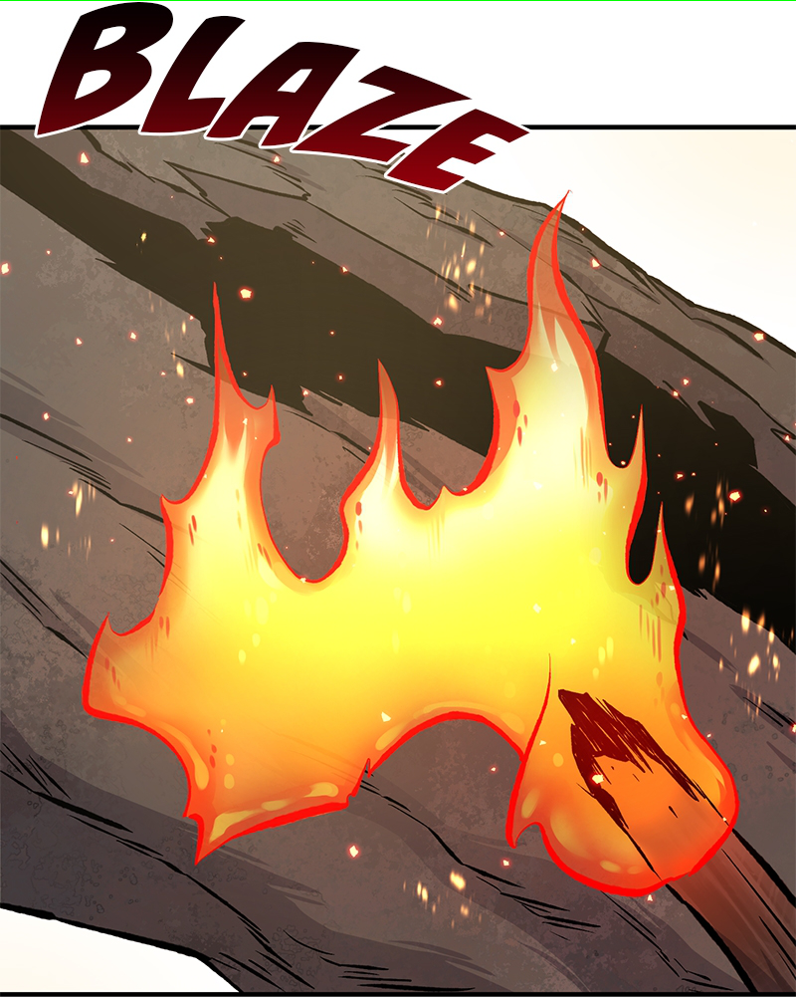

img2


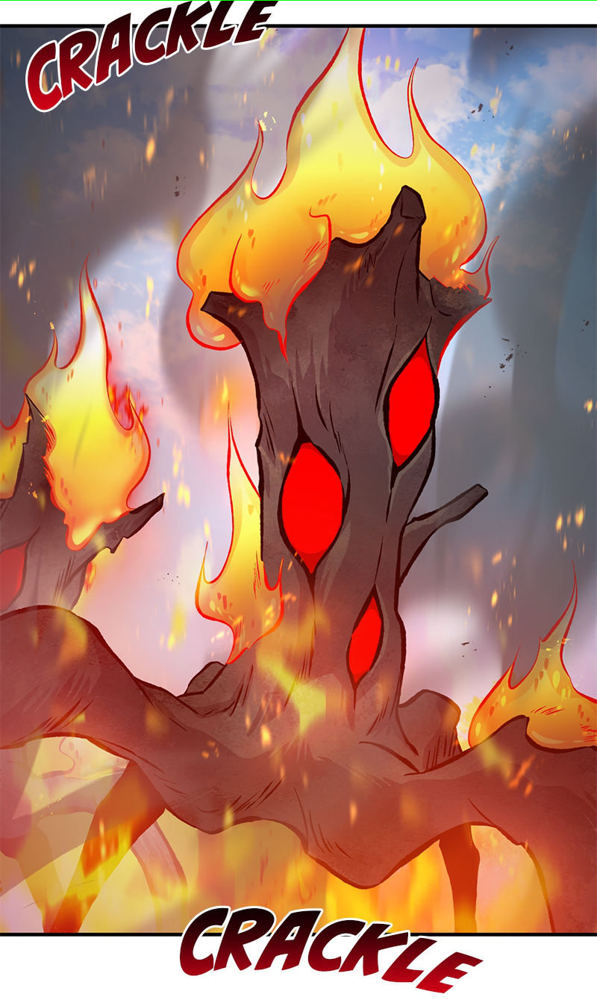

img3


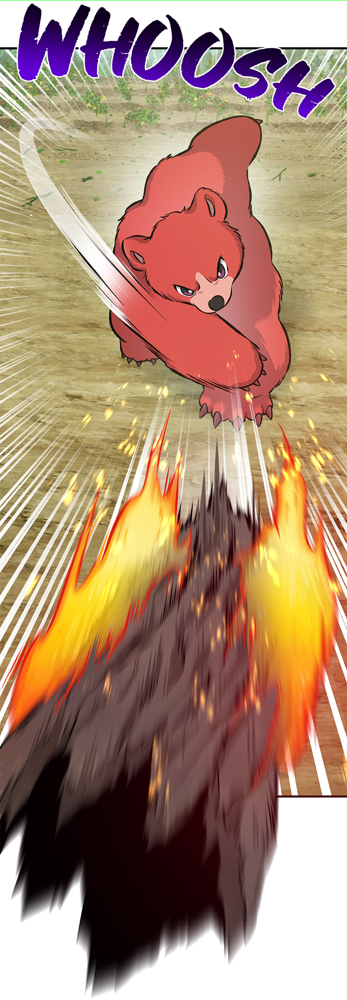

In [23]:
# Demonstrates pages/images my scraper extracts from the sample episode
for idx, segmented_img in enumerate(sample_segmented_imgs):
    print(f"img{idx+1}")
    display(segmented_img)

## Series Scraping Process

In [27]:
# Scraping Functions

async def fetch_series_url_to_series_dict(session, comic_series_url, series):
    """
    Helper function for create_series_url_to_seriess_dict. 
    Fetches each webpage containing the episodes for a given series (Most series have multiple webpages of episodes containing 9 each)

    Args:
        session (aiohttp.client.ClientSession()): Allows asynchronous processing of requests
        comic_series_url (string): URL for the first webpage of episodes for WebToon original comic series 
        series (string): Series associated with the comic
    Returns:
        episode_url_to_series_dict(Dict(string,string)): A Dictionary mapping all URLs for one series to their associated series
    """
    async with session.get(comic_series_url) as response: # Request response
        series_url_to_series_dict = {}
        
        r = await response.text() # Await a response
        soup = BeautifulSoup(r, 'html.parser') # Use BeautifulSoup on response

        total_no_episodes = int(soup.find('li', class_='_episodeItem')['data-episode-no']) # Finds the total number of episodes for a series
        total_no_pages = math.ceil(total_no_episodes/9) # Finds the total number of webpages encompassing all the episodes for a series
        for page_no in range(1,total_no_pages+1):
            series_url_to_series_dict[f"{comic_series_url}&page={page_no}"] = series # Adds &page={page_no} to the base link for a series to get every webpage for a series
        return series_url_to_series_dict


async def create_series_url_to_series_dict():
    """
    Creates a dictionary associating the URLs for each WebToons original comic series to its associated series.

    Returns:
        series_url_to_series_dict (Dict(string,string)): A Dictionary mapping comic series URLs to their associated series
    """
    series_url_to_series_dict = {}
    start = time.time()

    # Get base urls (first webpage for a series containing the 9 most recent episodes; No &page={page_no}) for each series
    
    originals_url = "https://www.webtoons.com/en/originals" # URL for WebToons original comic series
    r = requests.get(originals_url)
    soup = BeautifulSoup(r.text, 'html.parser')

    completed_comics = soup.find('div', class_='daily_section on').find_all('a', href=True) # Get HTML objects of all completed series

    for comic_series in completed_comics:
        series_url = comic_series['href']
        series = comic_series.find('p', class_="subj").text
        series_url_to_series_dict[series_url] = series # Add URL : associated series for all completed series
    
    ongoing_comics_days = soup.find_all('div', class_=re.compile('daily_section\s+_list_\w*')) # Get HTML objects of lists of ongoing series released on each day of the week
    
    for ongoing_comics_day in ongoing_comics_days:
        daily_ongoing_comics = ongoing_comics_day.find_all('li') # Get HTML objects of all ongoing series for each day of the week
        for comic_series in daily_ongoing_comics:
            series_url = comic_series.find('a', href=True)['href']
            series = comic_series.find('p', class_="subj").text
            series_url_to_series_dict[series_url] = series # Add URL : associated series for all ongoing series

    # Get all urls (each webpage for a series containing at most 9 episodes) for each series
    
    tasks = []
    async with aiohttp.ClientSession() as session: # Allows asynchronous processing of requests
        async with asyncio.TaskGroup() as tg: # Gathers all tasks (if any error, the whole thing errors)
            for comic_series_url, series in series_url_to_series_dict.items():
                task = tg.create_task(fetch_series_url_to_series_dict(session, comic_series_url, series)) # Create task for fetching 
                tasks.append(task)
    series_url_to_series_dict = {comic_series_url: series for task in tasks for comic_series_url, series in task.result().items()} # Extract and concatenate dictionaries inside finished tasks
    
    print(f"Finished creating series url to series dict in {time.time()- start : .3f}s")
    return series_url_to_series_dict


async def fetch_episode_url_to_series_dict(session, comic_series_url, series):
    """
    Helper function for create_episode_url_with_seriess_dict. 
    Fetches the episode_url_to_series_dict for a given series

    Args:
        session (aiohttp.client.ClientSession()): Allows asynchronous processing of requests
        comic_series_url (string): WebToon original comic series URL 
        series (string): Series associated with the comic
    Returns:
        episode_url_to_series_dict(Dict(string,string)): A Dictionary mapping comic episode URLs from one series to their associated series
    """
    async with session.get(comic_series_url, timeout=None) as response: # Request response
        episode_url_to_series_dict = {}
        
        r = await response.text() # Await a response
        soup = BeautifulSoup(r, 'html.parser') # Use BeautifulSoup on response

        comic_episodes = soup.find_all('li', class_='_episodeItem') # Get HTML objects of all episodes of each series
        for episode in comic_episodes:
            episode_url = episode.find('a', href=True)['href']
            episode_url_to_series_dict[episode_url] = series # Add URL : associated series for all episodes
        
        return episode_url_to_series_dict


async def create_episode_url_to_series_dict(series_url_to_series_dict): # Scrape episode URLs for each comic series URL
    """
    Creates a dictionary associating each WebToons original comic episode URL to its associated series.

    Args:
        series_url_to_series_dict (Dict(string,string)): A Dictionary mapping comic series URLs to their associated seriess
    Returns:
        episode_url_to_series_dict (Dict(string,string)): A Dictionary mapping comic episode URLs to their associated seriess
    """
    tasks = []
    start = time.time()
    async with aiohttp.ClientSession() as session: # Allows asynchronous processing of requests
        async with asyncio.TaskGroup() as tg: # Gathers all tasks (if any error, the whole thing errors)
            for comic_series_url, series in series_url_to_series_dict.items():
                task = tg.create_task(fetch_episode_url_to_series_dict(session, comic_series_url, series)) # Create task for fetching 
                tasks.append(task)
    episode_url_to_series_dict = {comic_episode_url: series for task in tasks for comic_episode_url, series in task.result().items()} # Extract and concatenate dictionaries inside finished tasks
    
    print(f"Finished creating episode url to series dict in {time.time()- start : .3f}s")
    return episode_url_to_series_dict


def segment_episode(episode_img):
    width, height = episode_img.size
    prev_row = False
    top = 0
    bottom = 0
    cropped_imgs = []
    
    for y in range(height): # Iterate over rows
        color = episode_img.getpixel((0,y))
        full_row = True
        for x in range(width):
            if episode_img.getpixel((x,y)) != color:
                full_row = False
                break
        if full_row:
            if not prev_row:
                bottom = y
                if bottom-top > 300 and bottom-top < 2000:
                    cropped_imgs.append(episode_img.crop((0, top, width, bottom)))
            prev_row = True
        else:
            if prev_row:
                top = y
            prev_row = False
    
    cropped_imgs.sort(key=lambda img: abs(math.log(img.size[1]/img.size[0]))) # sort by squareness
    
    return cropped_imgs[:3] # top 3 squarest images

async def fetch_page_img(session, comic_page_url, start):
    async with session.get(comic_page_url, headers={"referer": "https://www.webtoons.com/"}, timeout=None) as response: # Request response
        img = None
        try:
            r = await response.content.read()
            img = Image.open(io.BytesIO(r))
        except BrokenPipeError:
            print(f"BrokenPipeError for {comic_page_url} at {time.time()-start}")
        except UnidentifiedImageError:
            print(f"UnidentifiedImageError for {comic_page_url} at {time.time()-start}")
        return img

async def download_jpg(jpg_path, cropped_img):
    img_byte_arr = io.BytesIO()
    cropped_img.save(img_byte_arr, format='JPEG')
    img_data = img_byte_arr.getvalue()
    async with aiofiles.open(jpg_path, "wb") as jpg_file:
        await jpg_file.write(img_data)

async def segment_and_scrape_episode(session, comic_episode_url, series, image_dir, semaphore, start):
    """
    Helper function for segment_and_scrape_episodes
    Segments, scrapes, and downloads a given episode

    Args:
        session (aiohttp.client.ClientSession()): Allows asynchronous processing of requests
        comic_episode_url (string): WebToon original comic episode URL 
        series (string): Series associated with the comic
        image_dir (string): Root directory for images
        semaphore: Semaphore for concurrent tasks
        start: start time of segment_and_scrape_episodes
    """
    async with session.get(comic_episode_url, headers={"referer": "https://www.webtoons.com/"}, timeout=None) as response: # Request response
        page_url_series_dict = {}
        try:
            async with semaphore:
                r = await response.text() # Await a response
                soup = BeautifulSoup(r, 'html.parser') # Use BeautifulSoup on response
                page_viewer = soup.find('div', class_=re.compile('^viewer_img _img_viewer_area'))
                if not page_viewer: # Ignore any episodes with abnormal HTML formatting
                    print(f"dropout {comic_episode_url}")
                    return {} # Note: 68 episodes ignored
                pages = page_viewer.find_all('img', class_='_images')
    
                imgs = []
                total_height = 0
                
                for page in pages:
                    page_url = re.sub("\?type=\w*", "", page['data-url']) # Get url for a comic page while removing its image type
                    img = await fetch_page_img(session, page_url, start)
                    if total_height > 65500: # 65500 is the max image dimension for Pillow
                        break
                    total_height += img.size[1]
                    imgs.append(img)
    
                max_width = max([img.size[0] for img in imgs])
    
                episode_img = Image.new('RGB', (max_width, total_height))
        
                y_offset = 0
                for img in imgs:
                    if img.size[0] != max_width:
                        img = img.resize((max_width, int(img.size[1] * max_width / img.size[0])), Image.Resampling.LANCZOS)
                    episode_img.paste(img, (0,y_offset))
                    y_offset += img.size[1]
    
                counter = 0
                for page_img in segment_episode(episode_img):
                    series_dir = os.path.join(image_dir, series)
                    download_path = os.path.join(series_dir, f"{series}_ep{comic_episode_url[-1]}_{counter}.jpg")
                    await download_jpg(download_path, page_img)
                    counter += 1
        except BrokenPipeError:
            print(f"BrokenPipeError for {comic_episode_url} at {time.time()-start}")
        except aiohttp.ClientOSError:
            print(f'Connection reset by peer for {comic_episode_url} at {time.time()-start}')
            await asyncio.sleep(10)
            await segment_and_scrape_episode(session, comic_episode_url, series_dir, semaphore, start)
        except AssertionError:
            print(f'Assertion error. Skipping {comic_episode_url} at {time.time()-start}')
            
        
async def segment_and_scrape_episodes(episode_url_to_series_dict, k_episodes, image_dir='comic_series', semaphore = asyncio.Semaphore(10)): # Scrape episode URLs for each comic series URL
    """
    Segments, scrapes, and downloads all given episode, sorting them into directories by their series.

    Args:
        episode_url_to_series_dict (Dict(string,string)): A Dictionary mapping comic episode URLs to their associated series
        k_episodes: Number of episodes to be scraped
        image_dir: Root directory for images
        semaphore: Semaphore for concurrent tasks
    """
    start = time.time()
    episode_url_to_series_dict = dict(list(episode_url_to_series_dict.items())[:k_episodes])
    os.makedirs(image_dir, exist_ok=True)
    for series in set(episode_url_to_series_dict.values()):
        series_dir = os.path.join(image_dir, series)
        os.makedirs(series_dir, exist_ok=True)
    async with aiohttp.ClientSession() as session: # Allows asynchronous processing of requests
        async with asyncio.TaskGroup() as tg: # Gathers all tasks (if any error, the whole thing errors)
            for comic_episode_url, series in episode_url_to_series_dict.items():
                task = tg.create_task(segment_and_scrape_episode(session, comic_episode_url, series, image_dir, semaphore, start)) # Create task for fetching 
    
    
    print(f"Finished segmenting and scraping episodes in {time.time()- start : .3f}s")

In [29]:
# Scraping process
k_episodes = 3000 # Number of episodes scraped
series_url_to_series_dict = await create_series_url_to_series_dict()
episode_url_to_series_dict = await create_episode_url_to_series_dict(series_url_to_series_dict)
await segment_and_scrape_episodes(episode_url_to_series_dict, k_episodes)

Finished creating series url to series dict in  14.596s
Finished creating episode url to series dict in  161.205s
Finished segmenting and scraping episodes in  26.277s
